## Decision Tree Regression 

#### Apply ML algorithms
Linear Regression  
Lasso Regression  
Decision Tree Regressor  
KNN Regressor  
RandomForestRegressor  
Xgboost Regressor  
Huperparameter Tuning  
ANN- Artificial Neural Network  

In [59]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Data Collection and Preprocessing

In [60]:
df=pd.read_csv('../Data/Real-Data/Real_Combine.csv')

In [61]:
df.head()   # used for testing if the object has the right kind of data in it. 

,T,TM,Tm,SLP,H,VV,V,VM,PM 2.5
0,31.3,34.4,28.1,1001.8,74.0,4.0,8.3,14.8,27.88
1,30.2,33.6,26.4,1000.9,78.0,3.4,5.6,7.6,29.19
2,29.0,30.2,28.2,1000.0,91.0,4.0,4.6,7.6,28.69
3,30.5,34.8,26.8,997.6,77.0,4.0,4.6,9.4,18.02
4,30.4,32.4,27.6,997.1,79.0,4.0,7.0,9.4,9.96


<AxesSubplot:>

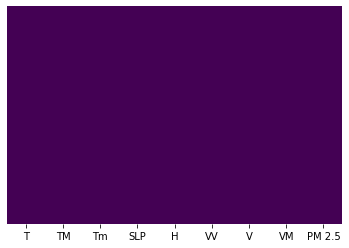

In [62]:
## Check for null values

sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

In [63]:
df=df.dropna()   # by default it drops the row which contains the missing value

In [64]:
X=df.iloc[:,:-1] ## independent features
y=df.iloc[:,-1] ## dependent features

In [65]:
## check null values
X.isnull()

,T,TM,Tm,SLP,H,VV,V,VM
0,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...
770,False,False,False,False,False,False,False,False
771,False,False,False,False,False,False,False,False
772,False,False,False,False,False,False,False,False
773,False,False,False,False,False,False,False,False


In [66]:
y.isnull()

0      False
1      False
2      False
3      False
4      False
       ...  
770    False
771    False
772    False
773    False
774    False
Name: PM 2.5, Length: 775, dtype: bool

### Feature Selection

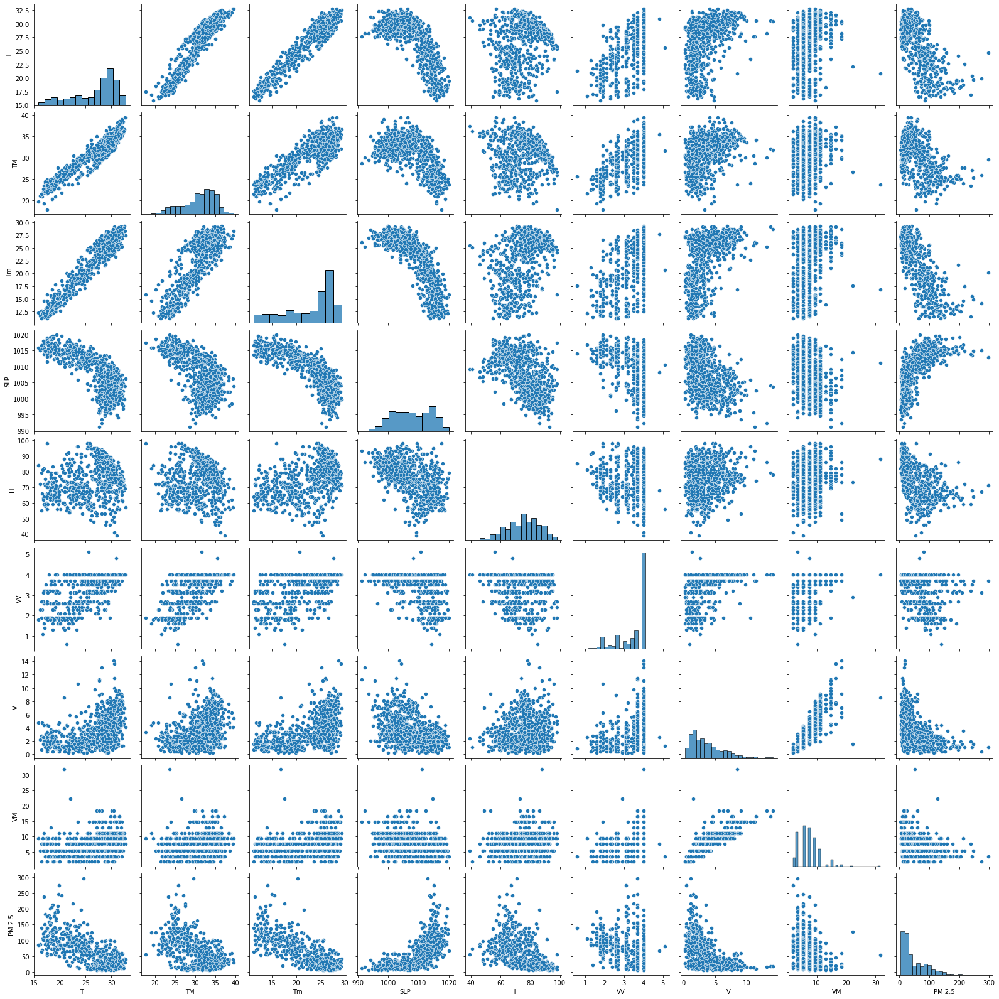

In [67]:
sns.pairplot(df) # pairplot

In [10]:
df.corr()

,T,TM,Tm,SLP,H,VV,V,VM,PM 2.5
T,1.000000,0.935524,0.957816,-0.757420,0.266486,0.718663,0.437618,0.276918,-0.730732
TM,0.935524,1.000000,0.822246,-0.602902,-0.000672,0.694784,0.355071,0.221702,-0.559624
Tm,0.957816,0.822246,1.000000,-0.811434,0.462392,0.671069,0.441991,0.279698,-0.794618
SLP,-0.757420,-0.602902,-0.811434,1.000000,-0.541203,-0.563667,-0.450169,-0.292371,0.701662
H,0.266486,-0.000672,0.462392,-0.541203,1.000000,0.071798,0.164732,0.088698,-0.507403
VV,0.718663,0.694784,0.671069,-0.563667,0.071798,1.000000,0.388416,0.293956,-0.498137
V,0.437618,0.355071,0.441991,-0.450169,0.164732,0.388416,1.000000,0.827395,-0.446214
VM,0.276918,0.221702,0.279698,-0.292371,0.088698,0.293956,0.827395,1.000000,-0.310336
PM 2.5,-0.730732,-0.559624,-0.794618,0.701662,-0.507403,-0.498137,-0.446214,-0.310336,1.000000


### Correlation Matrix with Heatmap
Correlation states how the features are related to each other or the target variable.

Correlation can be positive (increase in one value of feature increases the value of the target variable) or negative (increase in one value of feature decreases the value of the target variable)

Heatmap makes it easy to identify which features are most related to the target variable, we will plot heatmap of correlated features using the seaborn library.

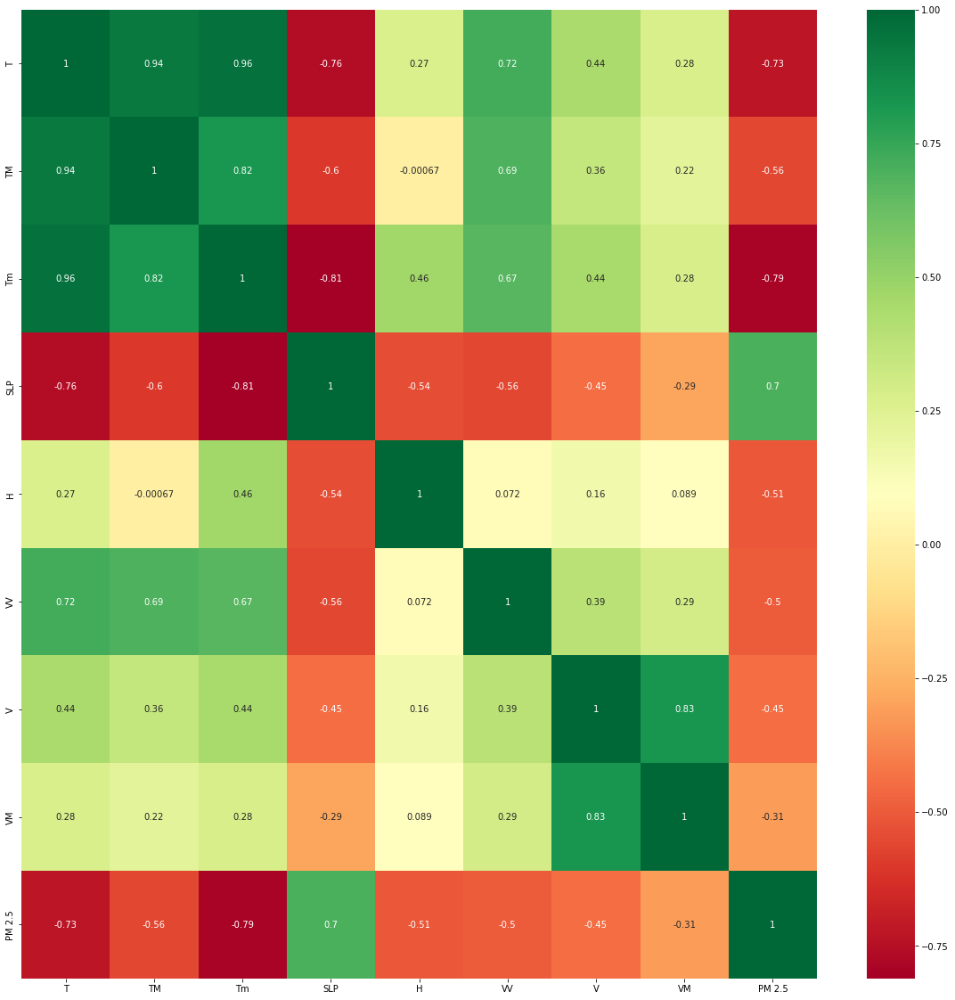

In [68]:
import seaborn as sns
#get correlations of each features in dataset
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(20,20))
#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

In [69]:
corrmat.index

Index(['T', 'TM', 'Tm', 'SLP', 'H', 'VV', 'V', 'VM', 'PM 2.5'], dtype='object')

#### Feature Importance
You can get the feature importance of each feature of your dataset by using the feature importance property of the model.

Feature importance gives you a score for each feature of your data, the higher the score more important or relevant is the feature towards your output variable.

Feature importance is an inbuilt class that comes with Tree Based Regressor, we will be using Extra Tree Regressor for extracting the top 10 features for the dataset.

In [70]:
from sklearn.ensemble import ExtraTreesRegressor
import matplotlib.pyplot as plt
model = ExtraTreesRegressor()
model.fit(X,y)

ExtraTreesRegressor()

In [21]:
X.head()

,T,TM,Tm,SLP,H,VV,V,VM
0,31.3,34.4,28.1,1001.8,74.0,4.0,8.3,14.8
1,30.2,33.6,26.4,1000.9,78.0,3.4,5.6,7.6
2,29.0,30.2,28.2,1000.0,91.0,4.0,4.6,7.6
3,30.5,34.8,26.8,997.6,77.0,4.0,4.6,9.4
4,30.4,32.4,27.6,997.1,79.0,4.0,7.0,9.4


In [71]:
y.head()

0    27.88
1    29.19
2    28.69
3    18.02
4     9.96
Name: PM 2.5, dtype: float64

In [15]:
print(model.feature_importances_)

[0.20049761 0.06074175 0.3754289  0.14278667 0.07633161 0.0637474
 0.05240818 0.02805788]


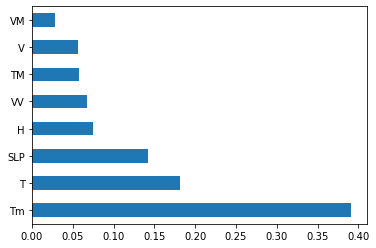

In [72]:
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(10).plot(kind='barh')
plt.show()

### Decision Tree Regressor

/Users/saditya/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='PM 2.5', ylabel='Density'>

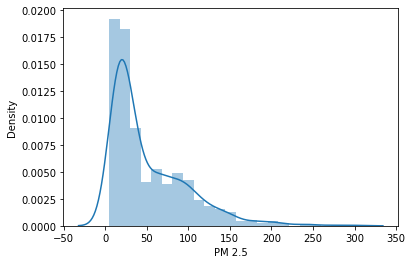

In [73]:
sns.distplot(y)

### Train Test split

In [74]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

In [76]:
from sklearn.tree import DecisionTreeRegressor

In [77]:
dtree=DecisionTreeRegressor(criterion="squared_error")  # initializing the DecisionTreeRegressor

In [78]:
dtree.fit(X_train, y_train)

DecisionTreeRegressor()

In [79]:
print("Coefficient of determination R^2 <-- on train set: {}".format(dtree.score(X_train, y_train)))

Coefficient of determination R^2 <-- on train set: 1.0


In [80]:
print("Coefficient of determination R^2 <-- on test set: {}".format(dtree.score(X_test, y_test)))
# overfitting case

Coefficient of determination R^2 <-- on test set: 0.43155987935180107


In [81]:
from sklearn.model_selection import cross_val_score
score=cross_val_score(dtree,X,y,cv=5)

In [82]:
print(score)
print(score.mean())

[ 0.35509528  0.34588771  0.366595   -0.19491741 -0.46880988]
0.08077014023183118


### Tree Visualization
Scikit learn actually has some built-in visualization capabilities for decision trees, you won't use this often and it requires you to install the pydot library, but here is an example of what it looks like and the code to execute this:

In [83]:
##conda install pydotplus
## conda install python-graphviz

from IPython.display import Image  
from six import StringIO
from sklearn.tree import export_graphviz
import pydotplus

In [84]:
features = list(df.columns[:-1])
features

['T', 'TM', 'Tm', 'SLP', 'H', 'VV', 'V', 'VM']

In [85]:
import os

os.environ['PATH'] = os.environ['PATH']+';'+os.environ['CONDA_PREFIX']+r"\Library\bin\graphviz"

In [86]:
dot_data = StringIO()  
export_graphviz(dtree, out_file=dot_data,feature_names=features,filled=True,rounded=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.885762 to fit



### Model Evaluation

In [87]:
prediction=dtree.predict(X_test)

/Users/saditya/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='PM 2.5', ylabel='Density'>

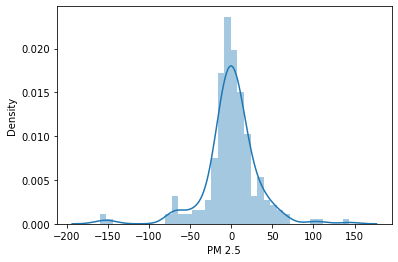

In [88]:
sns.distplot(y_test-prediction)

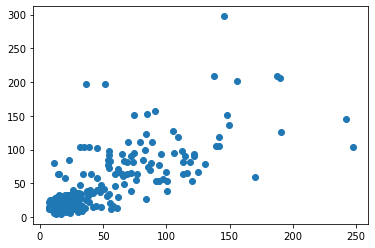

In [90]:
plt.scatter(y_test,prediction)

#### Hyperparameter Tuning Decision Tree Regressor

In [91]:
DecisionTreeRegressor()

DecisionTreeRegressor()

In [92]:
## Hyper Parameter Optimization

params={
 "splitter"    : ["best","random"] ,
 "max_depth"        : [ i for i in range(1, 50, 2)],
 "min_samples_leaf" : [ 1,2,3,4,5 ],
"min_weight_fraction_leaf":[0.1,0.2,0.3,0.4],
 "max_features" : ["auto","log2","sqrt",None ],
    "max_leaf_nodes":[None] + [i for i in range(5, 50, 5)]
    
}

In [93]:
## Hyperparameter optimization using GridSearchCV
from sklearn.model_selection import GridSearchCV

In [94]:
random_search=GridSearchCV(dtree,param_grid=params,scoring='neg_mean_squared_error',n_jobs=-1,cv=10,verbose=3)

In [95]:
def timer(start_time=None):
    if not start_time:
        start_time = datetime.now()
        return start_time
    elif start_time:
        thour, temp_sec = divmod((datetime.now() - start_time).total_seconds(), 3600)
        tmin, tsec = divmod(temp_sec, 60)
        print('\n Time taken: %i hours %i minutes and %s seconds.' % (thour, tmin, round(tsec, 2)))

In [ ]:
from datetime import datetime
# Here we go
start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X,y)
timer(start_time) # timing ends here for "start_time" variable

Fitting 10 folds for each of 40000 candidates, totalling 400000 fits
[CV 7/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-518.682 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1209.133 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3240.898 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-630.814 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-380.421 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, m

[CV 2/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3680.451 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.896 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-426.065 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1978.344 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1559.998 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1011.076 total t

[CV 8/10] END max_depth=1, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-962.854 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-608.071 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1996.531 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-3680.451 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-129.640 total time=   0.0s


[CV 9/10] END max_depth=1, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-7186.929 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-668.126 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0

[CV 8/10] END max_depth=1, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-809.653 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1459.252 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-618.924 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1996.531 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-3783.716 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.640 total time=   0.0s


[CV 2/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-4023.698 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-3005.258 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2225.380 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time= 

[CV 4/10] END max_depth=1, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1262.328 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=auto, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=

[CV 8/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-426.065 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1203.244 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-225.528 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-3800.777 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1996.531 total time=   0.0s
[

[CV 8/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1996.531 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-3842.545 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-129.640 total time=   0.0

[CV 4/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1358.586 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-541.637 total time= 

[CV 3/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-2031.684 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1358.544 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-665.793 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1714.196 total time=   0.0s
[CV 9/1

[CV 2/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-3680.451 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-129.640 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1701.952 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-608.896 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1683.836 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-665.793 total time=   0.0s
[CV 8/1

[CV 9/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1234.077 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-254.692 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2098.830 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.

[CV 10/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-670.237 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1823.063 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3783.716 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1166.253 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-608.896 total time=   0.0s
[CV 

[CV 8/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-421.377 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1897.030 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-6938.504 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-125.870 total time=   0.0s

[CV 6/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-773.989 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-843.745 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-823.862 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-729.373 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-2193.974 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-3309.115 total time=   0.0s
[CV 2

[CV 6/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-730.992 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-963.335 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1825.105 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-418.206 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/

[CV 8/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-725.328 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1232.485 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-5451.816 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-342.087 total time=   0.0s

[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2356.138 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-3344.174 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-392.667 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1390.434 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1312.450 total time=   

[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3783.716 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.640 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1267.117 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-608.896 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-626.203 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-518.682 total time=   0

[CV 9/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-700.309 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1882.832 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-3815.231 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-129.640 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1166.253 total time=   0.0

[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-771.231 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1893.662 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-588.167 total time=  

[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-129.640 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1397.898 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-608.896 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-626.203 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-518.682 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-426.065 total time=   0.0s
[CV 9/10]

[CV 8/10] END max_depth=1, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-426.065 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1209.133 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1835.753 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3618.333 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-396.513 total time=   0.0s


[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10

[CV 6/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-626.203 total time=   0.0s
[CV 7/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-518.682 total time=   0.0s
[CV 8/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-426.065 total time=   0.0s
[CV 9/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1209.133 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-2559.831 total time=   0.0s
[CV 2

[CV 9/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-700.309 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-4414.984 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-157.778 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2032.498 total time=   0.0

[CV 9/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1209.133 total time=   0.0s
[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-2453.614 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3616.935 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-391.332 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1175.559 total time=   0.

[CV 2/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-414.901 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1081.975 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-445.061 total time=   0.0s
[CV 

[CV 10/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.474 total time=   0.0s
[CV 1/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-3811.269 total time=   0.0s
[CV 3/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-512.488 total time=   0.0s
[CV 4/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1296.755 total time=   0.0s
[CV 5/10] END max_depth=1, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1156.303 total time=   

[CV 5/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-954.017 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-767.788 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-972.474 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-581.394 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-151.005 total time=   0.0s
[C

[CV 7/10] END max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-373.637 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-374.681 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1186.805 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-84.396 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-2005.526 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-3348.919 total time=   0.0s
[CV

[CV 9/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1396.549 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1906.755 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-3026.614 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-201.914 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1464.848 total t

[CV 7/10] END max_depth=3, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-6031.144 total time=   0.0s
[CV

[CV 4/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1061.218 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=

[CV 6/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1541.259 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-736.950 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-797.775 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-824.779 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=auto, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0

[CV 8/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-2069.921 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3409.370 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-300.276 total

[CV 5/10] END max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-770.816 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-604.614 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-576.173 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-416.103 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-712.805 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=log2, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-392.082 total time=   0.0s
[CV 1/10]

[CV 6/10] END max_depth=3, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-501.343 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-364.770 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-531.408 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1280.399 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-122.613 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-2566.065 total time=   0.0s
[CV 2

[CV 10/10] END max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=log2, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   

[CV 4/10] END max_depth=3, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-963.335 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1563.398 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-418.206 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-403.462 total time=   0.0s
[CV 10/1

[CV 4/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1926.430 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-589.063 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-178.504 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-4717.719 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s


[CV 9/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-716.460 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1831.003 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-6486.915 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-247.175 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1425.623 total time=   0.0s
[

[CV 5/10] END max_depth=3, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-319.158 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-578.132 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-397.580 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-305.724 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-905.430 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-84.396 total time=   0.0s
[CV 1/10] 

[CV 8/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-413.221 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1160.154 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-137.488 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1949.752 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-7313.815 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-696.072 total time=   0.0s
[CV 8

[CV 6/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-606.336 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1999.643 total time=  

[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-232.666 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1068.948 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-378.442 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-768.477 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-983.328 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-759.738 total time=   0.0s
[CV 9/10]

[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-594.395 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-6938.504 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-385.058 total time=   0.0s
[C

[CV 7/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-659.283 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1285.940 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-946.508 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-228.527 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1916.104 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-3759.750 total time=   0.0

[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1999.643 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1213.010 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1563.398 total time=   0.0s
[CV 7

[CV 8/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-468.260 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-596.698 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-275.834 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-5980.008 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-486.467 total time=   0.0s
[

[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-7607.390 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-398.135 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1387.765 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1081.764 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2004.562 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-579.630 t

[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   

[CV 8/10] END max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1215.738 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-482.366 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-182.988 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s


[CV 9/10] END max_depth=3, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1069.940 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-254.174 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/1

[CV 3/10] END max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-154.058 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.865 total time=   0.0s
[CV 5/10] END max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-451.699 total time=   0.0s
[CV 6/10] END max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-503.761 total time=   0.0s
[CV 7/10] END max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-373.637 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-374.681 total time=   0.0s
[CV 9/10]

[CV 7/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1732.691 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-5136.870 total time=   0.0s
[C

[CV 10/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-255.354 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 

[CV 9/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-282.915 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1888.660 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3002.909 total time=   0.0s
[CV 3/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-154.058 total time=   0.0s
[CV 4/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.865 total time=   0.0s
[

[CV 9/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-2396.794 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3679.273 total time=   0.0s
[CV 1/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1888.660 total time=   0.0s
[CV 2/10] END max_depth=3, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-3002.909 total time=   0.0s


[CV 10/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1807.731 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-4932.570 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-160.677 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1664.236 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-593.946 total time=   0

[CV 9/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1070.844 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s


[CV 3/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-465.749 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1048.925 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-505.864 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-564.929 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[

[CV 3/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-186.815 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1376.656 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-698.199 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1493.445 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-514.765 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-638.039 total time=   0

[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-559.699 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-619.522 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-471.044 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-296.500 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-963.852 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-188.561 total time=   0.

[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1212.543 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-667.842 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-468.724 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1307.950 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-653.724 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-2490.363 total time=   0.0s

[CV 1/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2293.467 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-4622.702 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-250.236 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1440.105 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-883.086 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1152.340 total time=  

[CV 3/10] END max_depth=5, max_features=auto, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-525.373 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=auto, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1024.412 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-432.928 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=auto, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-531.079 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=auto, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-660.628 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=auto, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-508.744 total time=   0.

[CV 5/10] END max_depth=5, max_features=auto, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-363.242 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=auto, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=auto, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-455.269 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=auto, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-460.608 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=auto, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-598.258 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=auto, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-710.535 total time=   0

[CV 2/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-5119.902 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-735.240 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1505.836 total time=   0.0s


[CV 2/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time= 

[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-355.032 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-670.964 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-160.651 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1603.091 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-3861.217 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-274.727 total time=   0.0s
[

[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1274.042 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1729.285 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-954.027 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-349.149 total time=   

[CV 2/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-4130.692 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-284.359 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-896.656 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-773.497 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-665.793 total time=   0

[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-444.363 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2132.017 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=log2, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-876.433 total time=   0.0s


[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-476.562 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1887.819 total time=  

[CV 4/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-963.335 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-418.206 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-403.462 total time=   0.0s
[CV 10/10

[CV 4/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-989.970 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1234.077 total time=   0.0s
[CV 10/10] END

[CV 10/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-144.791 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3023.287 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-389.243 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1099.315 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1372.681 total time=   

[CV 4/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-680.763 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1563.260 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-514.202 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1603.069 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-755.493 total time=   0.0s
[CV 10/

[CV 3/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1600.090 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1109.482 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-991.377 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1478.225 total time=  

[CV 6/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-684.621 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1041.804 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-93.306 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1895.220 total time=   0

[CV 8/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-629.197 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-899.244 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-311.419 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-5050.034 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-469.043 total time=   0.0s
[

[CV 5/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1500.857 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1023.521 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-425.890 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=

[CV 7/10] END max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-520.821 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1160.663 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-516.197 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-482.372 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total

[CV 5/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1888.870 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] EN

[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3002.909 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-195.986 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.865 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-464.288 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-503.761 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-446.879 total time=   0.0s
[CV 8/10] END 

[CV 10/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-200.962 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 

[CV 1/10] END max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-6208.348 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-467.712 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2004.562 total time= 

[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10

[CV 9/10] END max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1118.998 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-131.423 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=None, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[

[CV 6/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=5, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1759.651 total time=   0.0s
[CV 2

[CV 2/10] END max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=5, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10

[CV 10/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1814.320 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-7607.390 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-894.658 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1364.046 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-507.955 total time=   0

[CV 8/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2212.314 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-4819.924 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-158.369 total time=   0.0s


[CV 6/10] END max_depth=7, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2346.764 total time=   0.0s
[CV 2

[CV 10/10] END max_depth=7, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-2177.924 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3373.800 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1292.477 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-799.439 tot

[CV 9/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1963.789 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-5508.345 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-321.253 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1233.579 total time=   0.0

[CV 1/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/1

[CV 5/10] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2141.027 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-594.146 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-449.632 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-523.216 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-788.918 total time=   

[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-3729.176 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-111.113 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1577.259 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-803.514 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-502.129 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-445.363 total time=   0

[CV 2/10] END max_depth=7, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10

[CV 8/10] END max_depth=7, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-339.651 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1953.185 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-123.263 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2258.102 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-3584.290 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-161.492 total t

[CV 5/10] END max_depth=7, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-240.135 total time=   0.0

[CV 6/10] END max_depth=7, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-620.159 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-435.670 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-477.047 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-780.609 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-161.465 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-2933.861 total time=   0.0s
[CV 2/

[CV 10/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2204.513 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   

[CV 1/10] END max_depth=7, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-3051.674 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-3898.684 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-443.342 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1136.547 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-567.658 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1135.147 total time=  

[CV 4/10] END max_depth=7, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1286.663 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-579.578 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-760.144 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-477.047 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=log2, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-840.717 total time=   0.0s
[CV 8/1

[CV 10/10] END max_depth=7, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-142.573 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-2170.574 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3141.835 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-170.880 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1309.996 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-473.898 total time=   0.0s
[CV 

[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-225.171 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1853.419 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-3844.360 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1454.085 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1197.088 to

[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-828.919 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-483.001 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-659.553 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1411.091 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-136.979 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1895.245 total time= 

[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1166.921 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-514.202 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1267.713 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-703.331 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] 

[CV 5/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1094.021 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-948.525 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-813.322 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-524.292 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-475.711 total time=   0.0s
[

[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1722.076 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-220.912 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1213.010 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-706.838 total time=  

[CV 7/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-477.349 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-383.982 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1338.184 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-182.430 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-7512.088 total time=   0.0s
[C

[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-640.522 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-2344.774 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s

[CV 3/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-342.087 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-726.022 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-898.386 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1304.421 total time=   0.0s
[CV 9/10

[CV 5/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-475.099 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-602.527 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-471.125 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-535.309 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-866.521 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-233.207 total time=   0.0s
[CV 1/10]

[CV 1/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-2860.959 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-6905.947 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-495.213 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-350.356 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1358.544 total time=  

[CV 10/10] END max_depth=7, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2168.192 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2935.012 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-130.519 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1290.244 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-536.167 total time=   0

[CV 10/10] END max_depth=7, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1727.929 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-5473.273 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[

[CV 2/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-6938.504 total time=   0.0s
[CV 3/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-342.087 total time=   0.0s
[CV 4/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1156.760 total time=   0.0s
[CV 5/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-805.284 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-981.373 total time=   

[CV 5/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1064.857 total time=   0.0s
[CV 6/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1358.544 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-916.076 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-409.015 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-400.257 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-815.325 total time=   

[CV 8/10] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-372.276 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1186.805 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-94.750 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1880.950 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-3047.350 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-234.145 total time=   0.0s
[CV 4/1

[CV 7/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1001.099 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-404.443 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1224.790 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-252.391 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0

[CV 6/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=7, max_features=None, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2469.503 total time=   0.0s
[CV 2/

[CV 9/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1899.748 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-5668.454 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0

[CV 1/10] END max_depth=9, max_features=auto, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3095.906 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=auto, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3304.693 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-254.853 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1334.019 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-711.166 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-625.917 total time=   

[CV 7/10] END max_depth=9, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1424.362 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1241.407 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   

[CV 5/10] END max_depth=9, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-726.022 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1825.105 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-418.206 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1234.077 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-254.692 total time=   0.0s
[CV 1/1

[CV 4/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2711.744 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2171.073 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1724.962 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=

[CV 5/10] END max_depth=9, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-435.670 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-783.013 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-418.275 total time=   0.

[CV 6/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-794.280 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-418.206 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-254.692 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2233.750 total time=   0.0s
[CV 2/

[CV 6/10] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-607.507 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-636.984 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1322.721 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-797.971 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] E

[CV 3/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-159.664 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1118.729 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1081.691 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-871.297 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-522.282 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1638.102 total time=   

[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-592.364 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-2035.740 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3479.613 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-447.917 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-2019.434 total time=   0.0s
[

[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-712.805 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2038.480 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-5281.789 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[

[CV 4/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1202.555 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-254.987 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-484.312 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-377.280 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-636.151 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1939.847 total time=   0.0s
[CV 10/1

[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-587.340 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1879.277 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=log2, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[

[CV 8/10] END max_depth=9, max_features=log2, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1432.893 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=log2, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-769.992 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=log2, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-164.108 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=log2, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1821.550 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=log2, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3624.907 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=log2, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-118.303 total time=   0.0s


[CV 3/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-224.909 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1257.035 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-612.960 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-769.434 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1305.902 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-815.367 total time=   0.0s
[CV 9/10] END 

[CV 10/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-729.455 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-6051.170 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   

[CV 3/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1300.351 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-538.249 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1547.969 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1379.084 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-857.366 total time=   0.0s
[CV 9/1

[CV 9/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2149.899 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-2076.068 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-5191.466 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-394.001 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1413.740 total time=   0.0s


[CV 10/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1735.272 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-4783.601 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1148.657 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-486.718 total time=   0.0s
[CV

[CV 5/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-2045.977 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-386.737 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-2094.804 total time=

[CV 3/10] END max_depth=9, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-146.368 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1490.365 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-421.454 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-687.856 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-475.546 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-421.631 tota

[CV 1/10] END max_depth=9, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=9, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=None, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/1

[CV 2/10] END max_depth=9, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=9, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=9, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10

[CV 6/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1752.665 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-468.559 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-511.381 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-924.304 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-95.063 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0

[CV 7/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-5166.179 total time=   0.

[CV 4/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10

[CV 2/10] END max_depth=9, max_features=None, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-4660.265 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-437.749 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-310.811 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1045.248 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-115.753 total time=   0.0s
[CV 1/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0

[CV 6/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1829.439 total time=   0.0s
[CV 7/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=9, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-575.179 total tim

[CV 1/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/1

[CV 6/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1136.165 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1167.154 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-204.668 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=  

[CV 4/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=auto, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[C

[CV 8/10] END max_depth=11, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-452.093 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=  

[CV 9/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-191.505 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1882.854 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-389.273 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1121.955 total time=   0.0s
[

[CV 4/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1278.444 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-768.520 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-725.283 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-428.514 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1023.674 total ti

[CV 10/10] END max_depth=11, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-161.375 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0

[CV 2/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[C

[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   

[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-461.913 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1875.904 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-3741.848 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-367.067 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1224.779 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-486.718 total

[CV 4/10] END max_depth=11, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1366.327 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-419.612 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-768.823 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-518.363 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-777.530 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1186.520 total time=   0.0s
[C

[CV 8/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-630.808 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-2634.565 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-3746.480 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-250.695 total time= 

[CV 4/10] END max_depth=11, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1243.308 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-355.377 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-676.447 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-396.424 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-390.177 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1495.965 total time=   0.0s
[C

[CV 8/10] END max_depth=11, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-606.336 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1999.643 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time= 

[CV 2/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-4882.642 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-231.956 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1418.828 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-736.135 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-736.648 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1370.868 total time=   0.0s
[

[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-321.434 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-3623.870 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-5069.688 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-418.103 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1111.110 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-552.335 total tim

[CV 6/10] END max_depth=11, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-861.092 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-705.255 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-545.733 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-908.717 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-502.159 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1875.904 total time=

[CV 3/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2441.219 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-100

[CV 2/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-4172.896 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-2745.692 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-650.864 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1078.799 total t

[CV 9/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-712.805 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-248.111 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total tim

[CV 3/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-149.405 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-604.614 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-904.415 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV

[CV 6/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-561.069 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-472.249 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-422.598 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1111.941 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-171.005 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-2971.382 total time=   0.0s

[CV 9/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-2177.473 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3221.615 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-160.687 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1181.647 total time=  

[CV 7/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1165.776 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1232.485 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time

[CV 5/10] END max_depth=11, max_features=None, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=None, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=None, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=None, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10]

[CV 6/10] END max_depth=11, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-542.614 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[C

[CV 6/10] END max_depth=11, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1318.911 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1001.099 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-374.161 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total ti

[CV 3/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV

[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 7/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-500.541 total time=   0.0s
[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-315.270 total time=   0

[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2735.657 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-3601.762 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-405.255 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1308.624 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-674.283 total time=   0

[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s[CV 3/10] END max_depth=11, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV

[CV 8/10] END max_depth=11, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-693.515 total time=   0.0s
[CV 9/10] END max_depth=11, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-700.902 total time=   0.0s
[CV 10/10] END max_depth=11, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-621.858 total time=   0.0s
[CV 1/10] END max_depth=11, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=11, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=11, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   

[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-2833.517 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-3830.844 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1888.660 total

[CV 7/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1771.409 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-3937.465 total time=   0

[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-626.746 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1229.023 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-910.424 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total t

[CV 6/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2860.959 total time=   0.0s



[CV 7/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2041.443 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0

[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1969.771 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-7645.830 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-297.276 total time=   

[CV 2/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-5315.531 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-107

[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-869.971 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time= 

[CV 6/10] END max_depth=13, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-511.200 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=auto, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[C

[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[C

[CV 9/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1283.206 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1224.812 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1827.364 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3716.289 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-248.529 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1179.065 total time=  

[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-333.858 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.193 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-510.769 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-514.530 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-451.572 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-311.620 total time

[CV 10/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-6843.851 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-467.712 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1332.818 total ti

[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-266.478 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1121.955 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-600.457 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-736.648 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-612.058 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=log2, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1164.396 total time=   0.0s
[C

[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-600.457 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-561.187 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-481.881 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.522 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1055.417 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=log2, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-96.983 total time=   0.0s
[CV

[CV 10/10] END max_depth=13, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2367.078 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2466.702 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   

[CV 2/10] END max_depth=13, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-3756.577 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-373.258 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-525.630 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-573.987 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-880.534 total tim

[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-185.072 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-950.337 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-480.683 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-676.640 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-477.523 total time= 

[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-975.169 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total t

[CV 6/10] END max_depth=13, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-577.803 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-411.435 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1068.094 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-347.775 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-2181.990 total time=   0.0s

[CV 10/10] END max_depth=13, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1769.108 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3750.646 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-371.819 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1256.660 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-649.894 total time=   0.

[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1691.733 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-570.591 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-939.009 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-542.773 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-654.642 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-463.595 total time=   0.0s
[CV

[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-520.821 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-689.656 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1903.394 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.48

[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-403.462 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-254.692 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-7186.929 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=

[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-963.335 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1083.244 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1004.236 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-523.216 total time=   0.0s
[CV 10/

[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1563.398 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-794.280 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-989.970 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-403.462 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-624.711 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s

[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1124.253 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-4845.342 total ti

[CV 3/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-563.852 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1710.141 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-577.728 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-666.623 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-629.424 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-470.770 total time=   0.0s
[CV

[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-2039.874 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3423.683 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-276.599 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1304.374 total time=   

[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-883.900 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-444.006 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3000.303 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3741.848 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-358.400 total time=  

[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-108.818 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-766.996 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-798.093 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1841.341 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time

[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-738.424 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1083.244 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-794.280 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1385.724 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-523.216 total time=   0.0s
[

[CV 1/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1809.492 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-3829.177 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-363.109 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1448.381 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-622.741 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-571.863 total time=   0.0s
[

[CV 4/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1563.398 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-794.280 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-264.612 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1234.077 total time=   0.0s
[

[CV 6/10] END max_depth=13, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1236.042 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-973.287 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-434.392 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1070.169 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-667.032 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0

[CV 2/10] END max_depth=13, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-7607.390 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-555.589 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1265.814 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-419.001 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2004.562 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-803.289 total ti

[CV 5/10] END max_depth=13, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-571.463 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1639.862 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1103.368 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-596.404 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-523.216 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-893.972 total ti

[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-676.474 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1285.231 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-844.230 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-263.824 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=

[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-564.874 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-486.117 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1227.654 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-130.959 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=

[CV 2/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[C

[CV 10/10] END max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-145.943 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total

[CV 1/10] END max_depth=13, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=13, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=13, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=13, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=13, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=13, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[

[CV 6/10] END max_depth=13, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=13, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=13, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=13, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=13, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=13, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1699.758 total time=   0.0s

[CV 4/10] END max_depth=15, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1626.868 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-785.582 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1500.857 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=auto, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-708.023 total t

[CV 8/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-344.083 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1133.838 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-180.409 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=  

[CV 9/10] END max_depth=15, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2461.873 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-3899.165 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-407.819 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1370.923 total time

[CV 2/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[C

[CV 5/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-901.892 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-729.557 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-533.775 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1024.948 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-617.814 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=auto, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-234.535 total tim

[CV 3/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-342.087 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-813.218 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-626.508 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-580.759 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-179.637 total time

[CV 9/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-823.275 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.454 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0

[CV 4/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1365.280 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-513.100 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1473.134 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-633.058 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[C

[CV 6/10] END max_depth=15, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.1s
[CV 9/10] END max_depth=15, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=auto, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s


[CV 9/10] END max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-980.189 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-301.591 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1825.830 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3625.792 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-266.478 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1411.796 tot

[CV 7/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-802.746 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1128.553 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1235.668 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1869.966 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-3606.629 total tim

[CV 2/10] END max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-3756.364 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-354.011 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1174.219 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-389.563 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-576.936 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=

[CV 4/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2850.638 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-542.335 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-713.642 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-658.573 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-679.537 total time=   0

[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1338.101 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-911.263 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-837.468 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-686.985 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-570.775 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-3038.886 total time=   0.0s

[CV 3/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-161.403 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1362.151 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-453.886 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-721.244 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-501.476 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-433.947 total time=   0.0s
[CV

[CV 7/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1004.236 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-264.612 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-403.462 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2103.445 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=log2, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0

[CV 2/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-5416.746 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-982.140 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total t

[CV 5/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-910.687 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-794.280 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-418.206 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-618.051 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV

[CV 2/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1791.918 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1643.422 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total 

[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1859.286 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-545.851 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1811.900 total t

[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1021.744 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-247.908 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total t

[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1724.962 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1234.077 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0

[CV 4/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1065.563 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-507.031 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-794.097 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-483.281 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-426.415 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1069.991 total time=   0.0s
[C

[CV 1/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total ti

[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV

[CV 10/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-86.001 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total 

[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-368.188 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1021.305 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=None, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-355.585 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=None, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-438.875 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=None, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-477.691 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=None, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-325.216 total time

[CV 9/10] END max_depth=15, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-510.045 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1361.483 total time=

[CV 5/10] END max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=None, max_leaf_nodes=10, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[C

[CV 1/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2857.953 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-3790.109 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-389.202 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-594.063 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-684.621 total ti

[CV 2/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3490.335 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-467.712 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1250.576 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-460.250 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-711.597 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time

[CV 9/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1959.381 total time=   0.0s
[CV 2/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-6080.314 total time=   0.0s
[CV 3/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-208.760 total time=   0.0s
[CV 4/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1171.434 total time

[CV 6/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1167.154 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-1185.321 total time=   0.0s
[CV 6/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=15, max_features=None, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   

[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-588.873 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0

[CV 5/10] END max_depth=17, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-608.896 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-611.786 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-400.440 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-668.279 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.

[CV 4/10] END max_depth=17, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1245.731 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-426.016 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-841.627 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-599.323 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1386.341 total ti

[CV 7/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-559.201 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-772.822 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-971.542 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-739.702 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time= 

[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-481.503 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-122.446 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2037.018 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=auto, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-7607.390 total time=

[CV 4/10] END max_depth=17, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[C

[CV 5/10] END max_depth=17, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-429.970 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-787.842 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-401.525 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-397.662 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-186.027 total tim

[CV 9/10] END max_depth=17, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-665.854 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-170.486 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0

[CV 4/10] END max_depth=17, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1510.177 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=log2, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=

[CV 3/10] END max_depth=17, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-561.800 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-559.931 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-492.360 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=log2, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1391.078 total ti

[CV 6/10] END max_depth=17, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=log2, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-2227.968 total 

[CV 10/10] END max_depth=17, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-624.711 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2304.726 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-626.746 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=log2, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-910.424 total tim

[CV 1/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1890.479 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3474.303 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-229.632 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1253.595 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-460.237 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-573.853 total time=   0.0s
[

[CV 6/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-502.885 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-670.237 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=log2, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total ti

[CV 3/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-155.303 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1565.894 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-919.570 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-755.230 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-820.718 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1246.862 total tim

[CV 2/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-5315.531 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-384.879 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1134.075 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-996.704 total t

[CV 2/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-3625.792 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-264.147 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1635.457 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-600.457 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1316.184 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-854.354 total time=   0.0s
[

[CV 8/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-518.098 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1123.610 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-197.179 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-6113.390 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1078.799 total time= 

[CV 1/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1767.593 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-7572.459 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-563.319 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1365.280 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-513.100 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1086.286 total time=   0.0s


[CV 2/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total 

[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1181.668 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1447.695 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-2935.434 total 

[CV 5/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-513.100 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-626.203 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-645.679 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1647.998 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-433.846 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-225.528 total time=   0.0s
[C

[CV 6/10] END max_depth=17, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-2034.497 total 

[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-2194.275 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-3256.058 total time=   0

[CV 4/10] END max_depth=17, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1317.776 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1825.105 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-608.356 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=None, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time= 

[CV 4/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=None, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[C

[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-810.202 total time=   

[CV 3/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV

[CV 6/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1838.061 total time=   0.0s

[CV 10/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1804.150 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-4995.223 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-385.058 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1274.042 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total ti

[CV 4/10] END max_depth=17, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 3/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-208.894 total time=   0.0s
[CV 4/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1403.093 total time=   0.0s
[CV 5/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-668.509 total time=   0.0s
[CV 6/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1228.087 total time=   0.0s
[CV 7/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-577.027 total time

[CV 1/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1971.967 total time=   0.0s
[CV 2/10] END max_depth=17, max_features=None, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-3700.897 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total 

[CV 6/10] END max_depth=19, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-503.761 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-446.879 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-372.276 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1186.805 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-94.750 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1872.563 total time=   0.0s
[CV 2/

[CV 3/10] END max_depth=19, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV

[CV 10/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1162.652 total ti

[CV 2/10] END max_depth=19, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-4593.973 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-125.870 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-963.335 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=log2, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total tim

[CV 3/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-494.507 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-495.083 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1101.938 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=auto, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-320.710 total time= 

[CV 5/10] END max_depth=19, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2441.219 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-889.000 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-404.443 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=auto, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total 

[CV 4/10] END max_depth=19, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=auto, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[C

[CV 6/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-588.158 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-465.843 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-658.133 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1166.680 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-111.920 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-2972.328 total time=   0.0s

[CV 4/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-709.897 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1212.543 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=log2, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[C

[CV 9/10] END max_depth=19, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-474.376 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1254.630 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4593.973 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-876.433 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=log2, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   

[CV 2/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1446.543 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total 

[CV 4/10] END max_depth=19, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1224.779 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-770.816 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-771.624 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-502.336 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-473.551 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=log2, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-448.469 total time=   0.0s
[

[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-2586.327 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-531.820 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1006.565 total time=  

[CV 2/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-4568.555 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-149.031 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1097.514 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-542.836 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-842.524 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-651.835 total tim

[CV 9/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1503.783 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-5324.592 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-876.433 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=  

[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1213.010 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2068.563 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1724.962 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2

[CV 6/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1167.154 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1778.950 total time= 

[CV 1/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-125.870 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-126.671 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1272.506 total time=   0.0s


[CV 10/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-123.326 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-2292.907 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-280.793 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1863.949 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1372.681 total ti

[CV 7/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-545.692 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-377.529 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1069.835 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-314.711 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-5986.489 total time=   0

[CV 8/10] END max_depth=19, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-372.276 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1186.805 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-94.750 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-2416.082 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-3593.526 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-127.977 total time=   0.0s
[

[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-162.049 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-1269.992 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-700.901 total time=   

[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-544.406 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-550.894 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total 

[CV 10/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-2214.894 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1897.030 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-5324.592 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-284.359 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-2711.744 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.

[CV 3/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-382.958 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1383.196 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-2789.259 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=None, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total ti

[CV 9/10] END max_depth=19, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-786.254 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-113.189 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0

[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1791.918 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1213.010 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-949.123 total t

[CV 8/10] END max_depth=19, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=19, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-397.662 total time=   0.0s
[CV 10/10] END max_depth=19, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1049.448 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time= 

[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1182.055 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-446.400 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1006.886 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0

[CV 2/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2325.468 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1162.652 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=None, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total ti

[CV 10/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-125.882 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1815.443 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total ti

[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=None, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 7/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-651.188 total time=   0.0s
[CV 8/10] END max_depth=19, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-308.987 total time=   0.0s


[CV 10/10] END max_depth=19, max_features=None, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-582.720 total time=   0.0s
[CV 1/10] END max_depth=19, max_features=None, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=19, max_features=None, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=19, max_features=None, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=19, max_features=None, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=19, max_features=None, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0

[CV 4/10] END max_depth=21, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1396.453 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-792.358 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-504.660 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.

[CV 1/10] END max_depth=21, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1891.223 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3373.894 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-156.864 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1183.412 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-429.747 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-945.

[CV 4/10] END max_depth=21, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10

[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV

[CV 3/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=auto, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV

[CV 4/10] END max_depth=21, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1286.155 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-603.173 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-707.161 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-954.027 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1095.296 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-729.967 total tim

[CV 5/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-768.520 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-233.979 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 tot

[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-124.296 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-2412.051 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-607.507 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-435.670 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s


[CV 7/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-378.385 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.1

[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1866.165 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-3001.568 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-189.826 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1620.551 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-326.065 tota

[CV 9/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2264.209 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 t

[CV 9/10] END max_depth=21, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-1146.231 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=best;, score=-289.162 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3415.180 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-3856.888 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1309.086 total time

[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1942.065 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2515.227 total 

[CV 9/10] END max_depth=21, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1124.808 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-224.245 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1960.830 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-3690.035 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1640.754 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-3484.710 total time=  

[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-184.326 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-2179.594 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-3554.443 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-178.327 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1085.624 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-536.595 total tim

[CV 3/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-780.285 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total t

[CV 9/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-2223.672 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-4593.973 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-626.746 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-2711.744 total time=   

[CV 9/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2058.589 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1897.030 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4593.973 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-284.359 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=log2, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1926.430 total time=  

[CV 4/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-2466.702 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-692.973 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1078.799 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total 

[CV 1/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-3333.576 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-294.469 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-1187.678 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-617.029 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-661.541 total ti

[CV 8/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-709.201 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1379.984 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-2344.774 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-876.433 total time= 

[CV 8/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1491.552 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-844.097 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-220.165 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2356.138 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=  

[CV 9/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-777.459 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-581.186 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=

[CV 10/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-509.753 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1999.643 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-125.870 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1240.089 total time=   0.

[CV 5/10] END max_depth=21, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=None, max_leaf_nodes=None, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-490.203 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-499.715 total time=

[CV 4/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=None, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV

[CV 10/10] END max_depth=21, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2132.017 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=None, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.

[CV 6/10] END max_depth=21, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1500.857 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=21, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-400.257 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-752.596 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=None, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total ti

[CV 3/10] END max_depth=21, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=21, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=21, max_features=None, max_leaf_nodes=25, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV

[CV 1/10] END max_depth=21, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2098.830 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-5451.816 total time=   0.0s
[CV 3/10] END max_depth=21, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=21, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=21, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=21, max_features=None, max_leaf_nodes=30, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1262.328 total 

[CV 9/10] END max_depth=21, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=21, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-2403.325 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=None, max_leaf_nodes=40, min_samples_leaf=2, min_weight_fraction_leaf=0.2, splitter=random;, score=-3728.596 total time=   0.0s
[CV 1/10] END max_depth=21, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1886.984 total time=   0.0s
[CV 2/10] END max_depth=21, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=  

[CV 10/10] END max_depth=23, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=random;, score=-116.064 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=auto, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total

[CV 5/10] END max_depth=23, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-442.606 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[C

[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1330.282 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-734.028 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=auto, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-472.578 total time=   

[CV 2/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[C

[CV 7/10] END max_depth=23, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-543.670 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-667.866 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1203.244 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-248.667 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=auto, max_leaf_nodes=30, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=

[CV 3/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-977.363 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1089.181 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-2050.089 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=auto, max_leaf_nodes=15, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=random;, score=-1146.234 total 

[CV 1/10] END max_depth=23, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=auto, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-444.548 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1715.890 total time=   0

[CV 9/10] END max_depth=23, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1119.497 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-170.484 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1988.884 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-3504.706 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-168.569 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1214.275 total time

[CV 4/10] END max_depth=23, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1511.357 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-385.264 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.432 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-448.736 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-634.864 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=log2, max_leaf_nodes=None, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-2118.595 total tim

[CV 1/10] END max_depth=23, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2325.378 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-6168.031 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1051.015 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-901.892 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total t

[CV 9/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1234.077 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-370.564 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time

[CV 7/10] END max_depth=23, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=log2, max_leaf_nodes=15, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1874.848 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-2862.131 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-196.919 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=log2, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=best;, score=-1494.521 total time=   0.0s
[

[CV 6/10] END max_depth=23, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-620.159 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-483.587 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-843.926 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-129.062 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=log2, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s


[CV 3/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total 

[CV 2/10] END max_depth=23, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-698.034 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2271.764 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=log2, max_leaf_nodes=40, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total t

[CV 8/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-491.634 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1052.463 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-166.579 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1841.143 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-7414.104 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=log2, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-556.530 total time=  

[CV 3/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-266.478 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1720.992 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-324.555 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-1191.384 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-656.656 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=best;, score=-411.989 total time=   0.0s
[C

[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1309.249 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-863.036 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-910.687 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-711.945 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-1385.724 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=10, min_samples_leaf=4, min_weight_fraction_leaf=0.4, splitter=best;, score=-472.578 total time=   0.0s
[

[CV 4/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1097.573 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-538.166 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1162.464 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-603.539 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=random;, score=-1220.082 total t

[CV 1/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-2144.094 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-6227.450 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-378.067 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1411.796 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-623.328 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1329.112 total time=   0.0s


[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-472.968 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=25, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1016.258 total time=   0.

[CV 2/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1275.658 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1078.799 total 

[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=40, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1105.301 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-963.335 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1083.244 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1239.504 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-1385.724 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=sqrt, max_leaf_nodes=45, min_samples_leaf=5, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0

[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1400.538 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-608.032 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-587.014 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-391.041 total time=   0.0s
[C

[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-638.051 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=None, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=None, max_leaf_nodes=5, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/

[CV 4/10] END max_depth=23, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-882.548 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1729.285 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-910.344 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=10, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1396.549 total t

[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=None, max_leaf_nodes=15, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=random;, score=-2000.167 total time=   0.0s

[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-3007.575 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-158.339 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=45, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[C

[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-441.072 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-457.803 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=best;, score=-179.387 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=30, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-4321.515 total time=   0.

[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-103.734 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-1907.796 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=random;, score=-3249.111 total time=   0

[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-3793.469 total time=   0.0s
[CV 3/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-392.784 total time=   0.0s
[CV 4/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1414.004 total time=   0.0s
[CV 5/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-668.533 total time=   0.0s
[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-628.471 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=20, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-455.038 total tim

[CV 6/10] END max_depth=23, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-520.821 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1006.565 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-472.578 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-125.644 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=None, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total tim

[CV 7/10] END max_depth=23, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-361.323 total time=   0.0s
[CV 8/10] END max_depth=23, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-441.459 total time=   0.0s
[CV 9/10] END max_depth=23, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-876.734 total time=   0.0s
[CV 10/10] END max_depth=23, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-193.916 total time=   0.0s
[CV 1/10] END max_depth=23, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=23, max_features=None, max_leaf_nodes=35, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time= 

[CV 4/10] END max_depth=25, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1312.060 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-456.537 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-499.466 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-371.964 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-380.028 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=auto, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-1196.146 total tim

[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-295.012 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-1044.143 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0

[CV 8/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1335.336 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.3, splitter=random;, score=-210.606 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1959.297 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-4444.117 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time= 

[CV 9/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-1133.838 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.2, splitter=random;, score=-291.757 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=auto, max_leaf_nodes=20, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   

[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2669.961 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-6938.504 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-2466.702 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=auto, max_leaf_nodes=10, min_samples_leaf=1, min_weight_fraction_leaf=0.4, splitter=random;, score=-1061.218 total ti

[CV 8/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-350.307 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1221.688 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-194.196 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-3605.168 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=auto, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-159.611 total time=  

[CV 6/10] END max_depth=25, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-548.619 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-414.186 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-503.637 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-1112.714 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.1, splitter=random;, score=-138.386 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=30, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=best;, score=-1680.837 total time

[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-187.823 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1772.315 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-3744.484 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-167.035 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-1269.495 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=auto, max_leaf_nodes=35, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=best;, score=-578.412 total time=   0.0

[CV 5/10] END max_depth=25, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-486.718 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-612.181 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=auto, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-144.825 total time=   0.0s
[CV

[CV 8/10] END max_depth=25, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1285.552 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-622.402 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=log2, max_leaf_nodes=5, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-1379.984 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-714.861 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=best;, score=-581.186 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=log2, max_leaf_nodes=10, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-3122.970 total time=  

[CV 9/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.1, splitter=best;, score=-2004.015 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=auto, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1302.164 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=auto, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-604.297 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=auto, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-693.222 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=auto, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-543.275 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=auto, max_leaf_nodes=45, min_samples_leaf=1, min_weight_fraction_leaf=0.2, splitter=random;, score=-1391.078 total time

[CV 6/10] END max_depth=25, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-747.982 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-434.281 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-457.409 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-1211.697 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.2, splitter=random;, score=-440.588 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=log2, max_leaf_nodes=25, min_samples_leaf=4, min_weight_fraction_leaf=0.3, splitter=best;, score=-1875.904 total time

[CV 1/10] END max_depth=25, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1945.117 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-3113.573 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-180.568 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-1483.618 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-407.276 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=log2, max_leaf_nodes=20, min_samples_leaf=1, min_weight_fraction_leaf=0.1, splitter=best;, score=-641.852 total time=   0.0s
[

[CV 5/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1469.918 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-608.356 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-379.299 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-1220.082 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=3, min_weight_fraction_leaf=0.3, splitter=random;, score=-137

[CV 2/10] END max_depth=25, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-5524.695 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-152.225 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-1192.253 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-433.165 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-565.127 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=log2, max_leaf_nodes=30, min_samples_leaf=3, min_weight_fraction_leaf=0.1, splitter=best;, score=-366.266 total time=   0.0s
[C

[CV 3/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-358.400 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1270.813 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-726.022 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-910.687 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1239.504 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=log2, max_leaf_nodes=35, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-264.612 total time=   0.0s
[C

[CV 3/10] END max_depth=25, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-125.870 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-1269.754 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-738.424 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-948.243 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-681.999 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=log2, max_leaf_nodes=40, min_samples_leaf=3, min_weight_fraction_leaf=0.4, splitter=best;, score=-458.134 total time=   0.0s
[CV

[CV 7/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1239.504 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-1304.421 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-618.051 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=best;, score=-729.455 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-3122.970 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=2, min_weight_fraction_leaf=0.4, splitter=random;, score=-5760.946 to

[CV 7/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-632.056 total time=   0.0s
[CV 8/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-924.695 total time=   0.0s
[CV 9/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-1540.396 total time=   0.0s
[CV 10/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.1, splitter=random;, score=-970.772 total time=   0.0s
[CV 1/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-1676.412 total time=   0.0s
[CV 2/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=best;, score=-3729.736 total time=   0.0

[CV 2/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1417.582 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=15, min_samples_leaf=5, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total 

[CV 2/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1844.434 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1372.681 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1358.544 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=5, min_weight_fraction_leaf=0.2, splitter=random;, score=-1078.799 total 

[CV 2/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-7512.088 total time=   0.0s
[CV 3/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-974.013 total time=   0.0s
[CV 4/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2529.523 total time=   0.0s
[CV 5/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1255.034 total time=   0.0s
[CV 6/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-2789.259 total time=   0.0s
[CV 7/10] END max_depth=25, max_features=sqrt, max_leaf_nodes=35, min_samples_leaf=1, min_weight_fraction_leaf=0.3, splitter=random;, score=-1078.799 total 

In [96]:
random_search.best_params_

AttributeError: 'GridSearchCV' object has no attribute 'best_params_'

In [117]:
random_search.best_score_

-837.2053731411119

In [118]:
predictions=random_search.predict(X_test)

/Users/saditya/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='PM 2.5', ylabel='Density'>

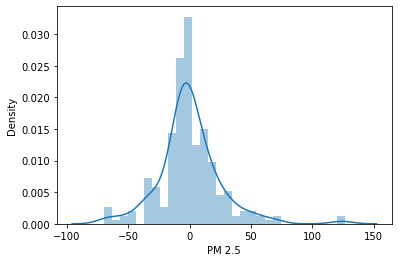

In [119]:
sns.distplot(y_test-predictions)

In [120]:
from sklearn import metrics

In [121]:
print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))

MAE: 17.103538962832303
MSE: 653.0739614146519
RMSE: 25.55531180429329


In [122]:
import pickle 

In [116]:
# open a file, where you ant to store the data
file = open('decision_regression_model.pkl', 'wb')

# dump information to that file
pickle.dump(random_search, file)